In [1]:
# Generic imports
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import PIL
import os
from sys import platform
from importlib import reload
import plotly.graph_objects as go

# Local imports
import sys
sys.path.append('../../../')
import stlstuff as sls
import imagestuff as ims
import statstuff as sts
import fourierstuff as fs

In [2]:
%matplotlib notebook

In [3]:
# Have to do this in case of different operating systems
if platform == "linux" or platform == "darwin":
    slash = '/'
else: # This is assumed to be Windows
    slash = '\\'
#print(slash)

In [4]:
# Graphics parameters
fontsize = 10
linewidth = 2
matplotlib.rcParams.update({'font.size': fontsize})

In [5]:
# Specify the file we want to analyze (and output file name)
pwd = os.getcwd(); startpos = len(pwd)-pwd[::-1].find(slash)
case = pwd[startpos:]; print(case)
cwd = os.getcwd(); i = cwd.index('crystals'); case_and_folder = cwd[i+9:]; print(case_and_folder)
Segmentroot='Segments2'; print(Segmentroot)

case3.2 (roughness)
2023-07-03/case3.2 (roughness)
Segments2


In [6]:
# Derivative names
Compressedfilename = Segmentroot+'_retrieved.npz'; print (Compressedfilename)
Originalfilename = Segmentroot+'_compr.npz'; print(Originalfilename)
Flattenedfilename = Segmentroot+'_compr_flat.npz'; print(Flattenedfilename)
Filteredfilename = Segmentroot+'_compr_flat_filt.npz'; print(Filteredfilename)

Segments2_retrieved.npz
Segments2_compr.npz
Segments2_compr_flat.npz
Segments2_compr_flat_filt.npz


In [7]:
# Get the retrieved surface
npzfile = np.load(Compressedfilename)
imageroot = np.array_str(npzfile['imageroot'])
dx,dy,cA,cB,cC,cD,Filename = ims.getc2('', 'SEMimages/', imageroot)
print("dx and dy", dx, dy)

SEMimages/case3.2-A.bmp
SEMimages/case3.2-B.bmp
SEMimages/case3.2-C.bmp
SEMimages/case3.2-D.bmp
dx and dy 1.102431 1.102431


In [8]:
nx1list = npzfile['nx1list']
nx2list = npzfile['nx2list']
ny1list = npzfile['ny1list']
ny2list = npzfile['ny2list']
solution = npzfile['solution']
nsegments = len(nx1list)

<IPython.core.display.Javascript object>


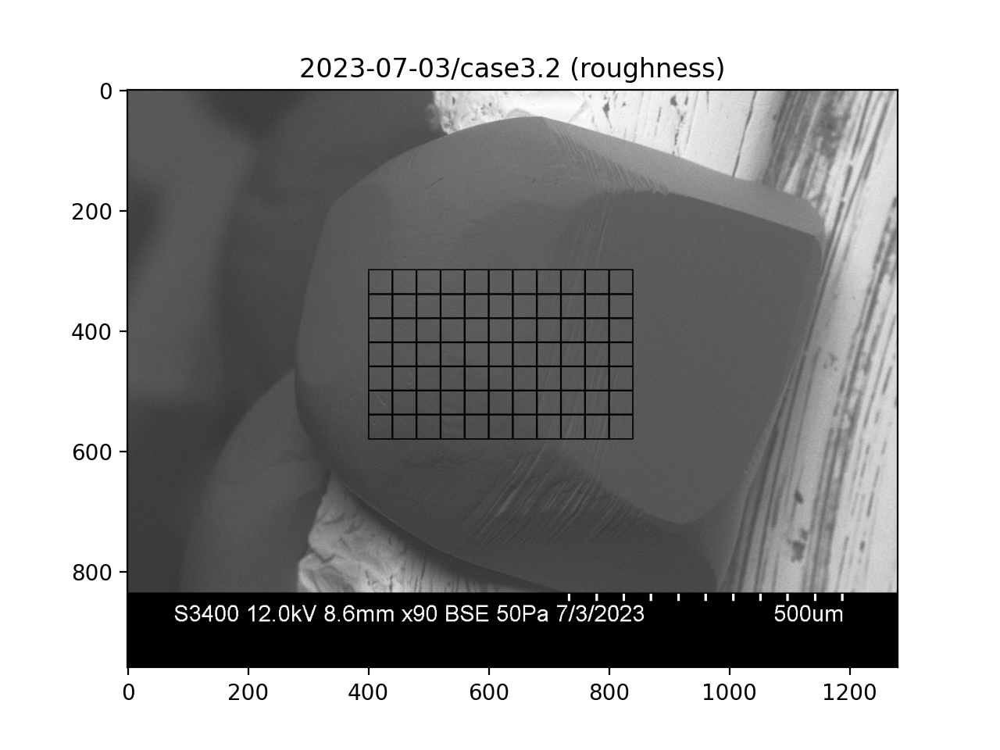

Text(0.5, 1.0, '2023-07-03/case3.2 (roughness)')

In [9]:
# Graph the segments
im = PIL.Image.open(Filename)
ny_im,nx_im = np.shape(im)
draw = PIL.ImageDraw.Draw(im)
for i in range(nsegments):
    nx1 = nx1list[i]
    nx2 = nx2list[i]
    ny1 = ny1list[i]
    ny2 = ny2list[i]
    ims.myrectangle(draw,(nx1,ny1),(nx2,ny2),2)
plt.imshow(np.asarray(im),cmap = 'Greys_r', vmin = 0,vmax = 255)
plt.title(case_and_folder)

In [10]:
# Flatten them
xseggrid, yseggrid, zseggrid, surf_xseggrid, surf_yseggrid, surf_zseggrid = ims.extractflat(npzfile,dx,dy)

In [11]:
# Report
print(np.shape(zseggrid[0]), \
      xseggrid[0][0,1]-xseggrid[0][0,0],yseggrid[0][1,0]-yseggrid[0][0,0])
print(np.shape(surf_zseggrid[0]), \
      surf_xseggrid[0][0,1]-surf_xseggrid[0][0,0],surf_yseggrid[0][1,0]-surf_yseggrid[0][0,0])

(39, 38) 1.1024309999999997 1.1024310000000002
(41, 41) 1.102431 1.102431


Working on segment  0
(39, 38)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


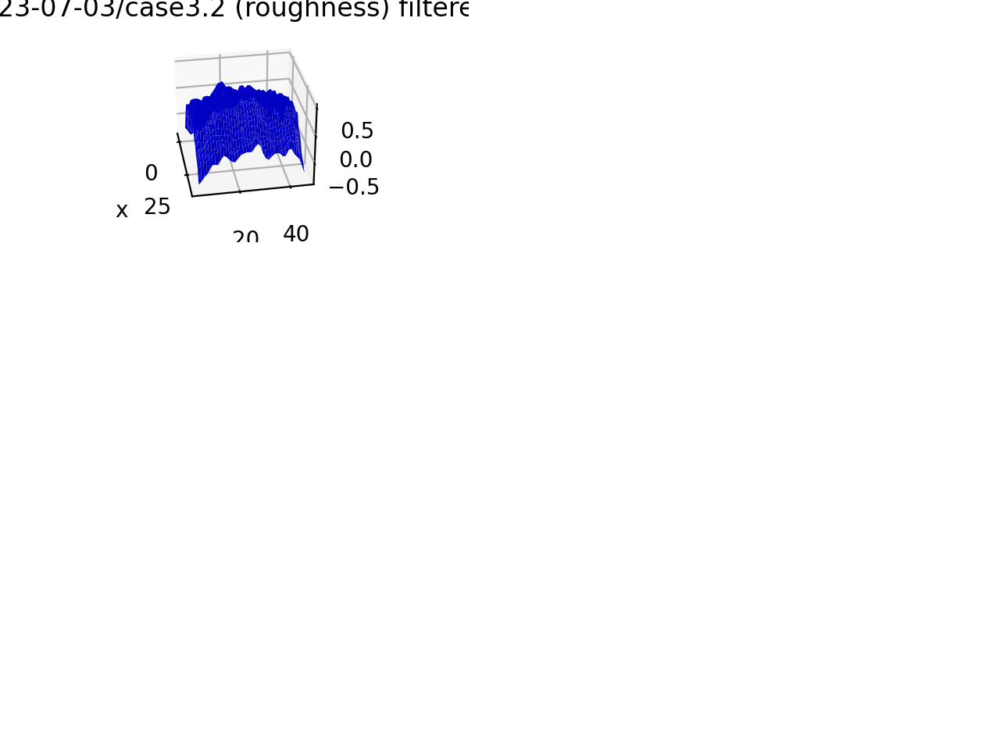

Segments2_compr_flat_filt_0_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.23895928205265562
std dev of height =  0.27006872542111515


<IPython.core.display.Javascript object>

Working on segment  1
(38, 40)


<IPython.core.display.Javascript object>


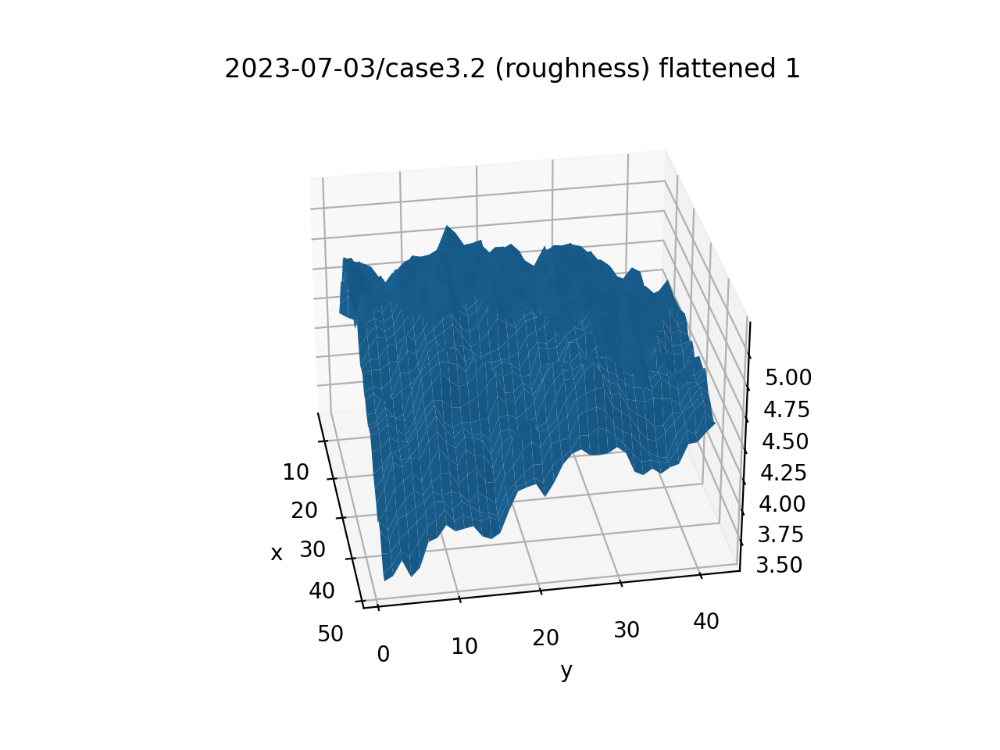

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_1_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.32121690932419134
std dev of height =  0.3697444219223232


<IPython.core.display.Javascript object>


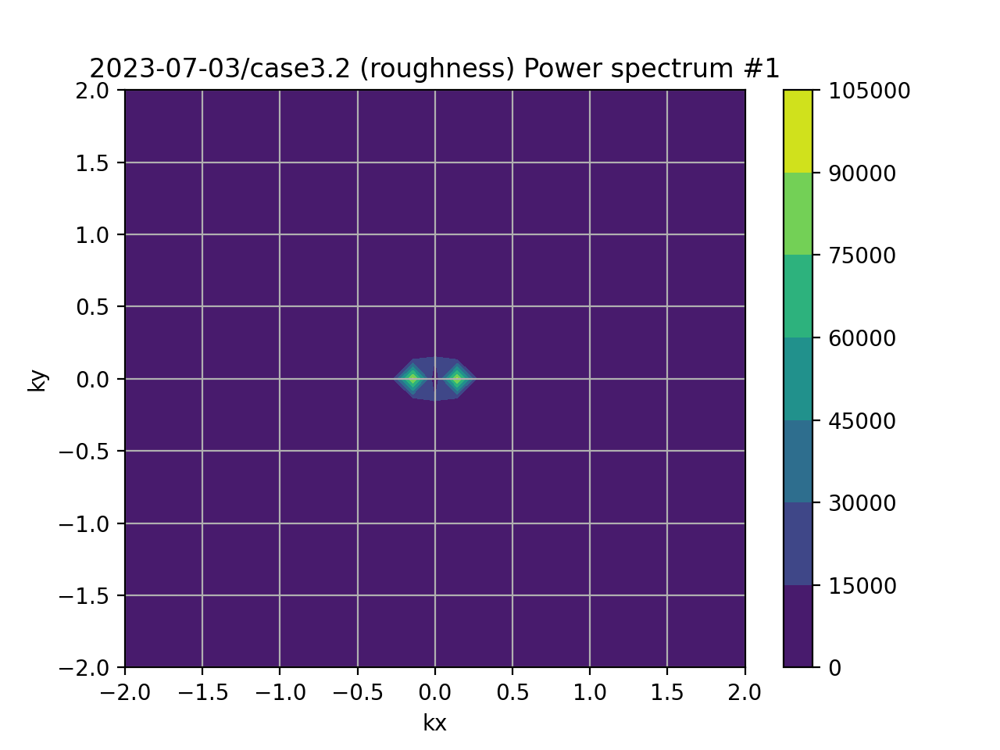

Working on segment  2
(37, 41)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_2_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2597957617483704
std dev of height =  0.3048832172336718


<IPython.core.display.Javascript object>


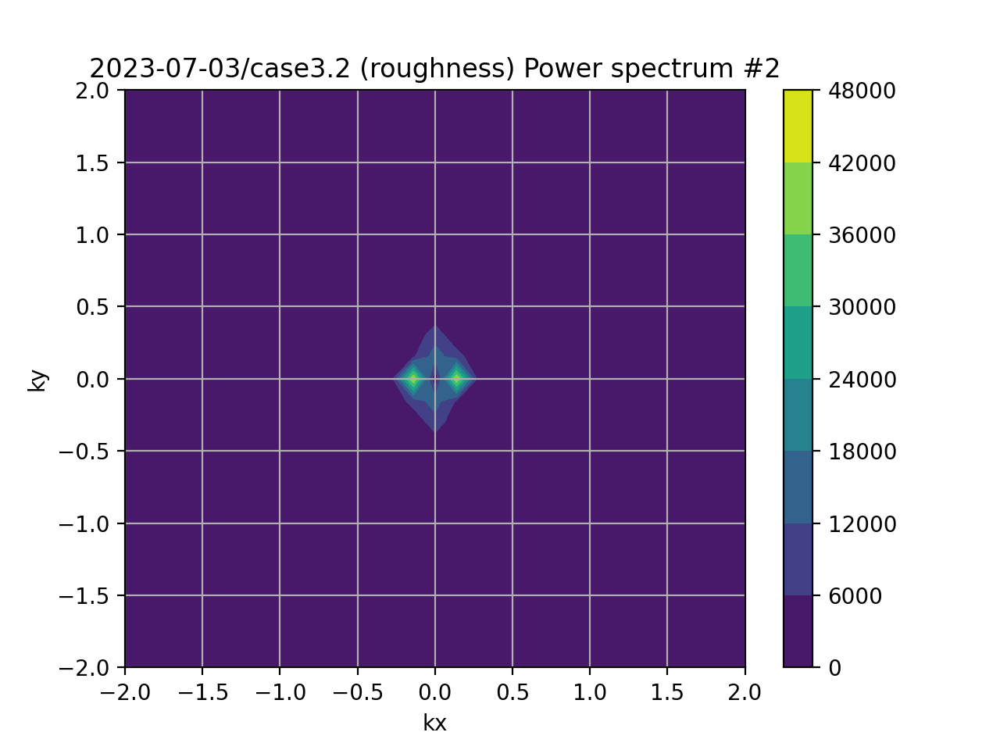

Working on segment  3
(37, 42)


<IPython.core.display.Javascript object>


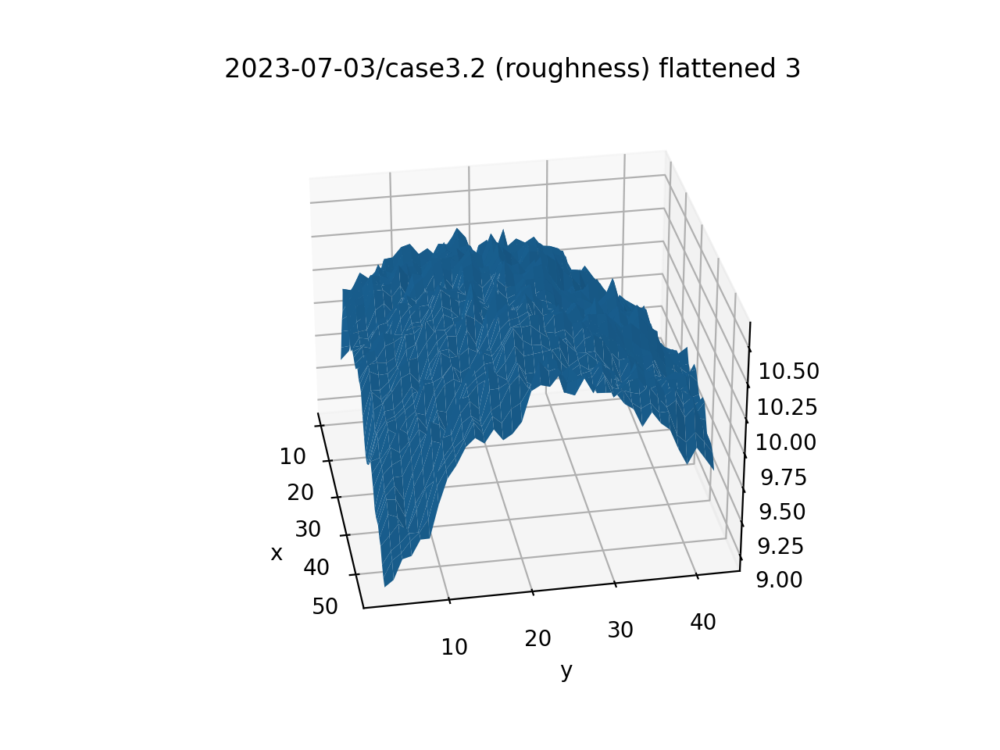

<IPython.core.display.Javascript object>


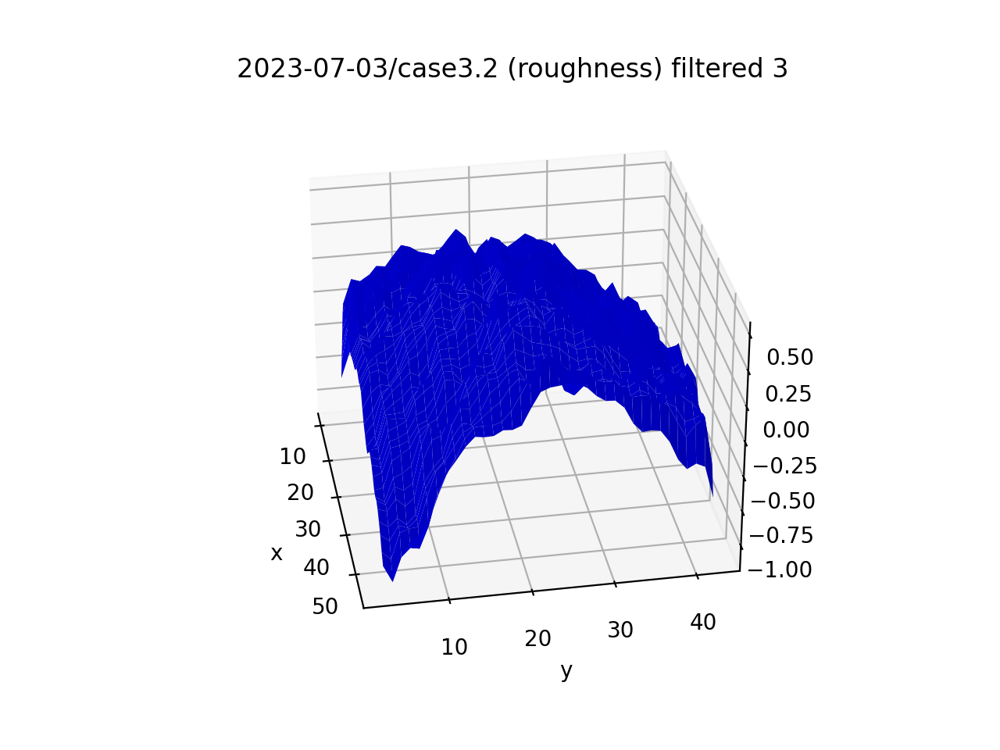

Segments2_compr_flat_filt_3_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2684638222609337
std dev of height =  0.3124575625319488


<IPython.core.display.Javascript object>

Working on segment  4
(37, 39)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


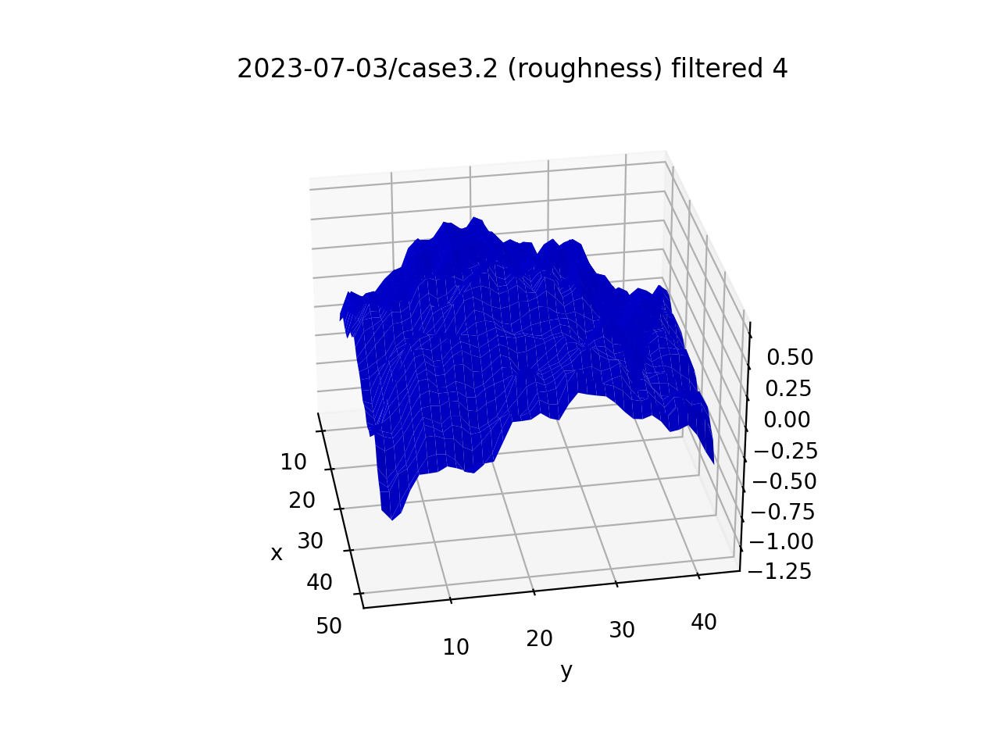

Segments2_compr_flat_filt_4_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.26072645002420836
std dev of height =  0.2995494286444615


<IPython.core.display.Javascript object>

Working on segment  5
(40, 34)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


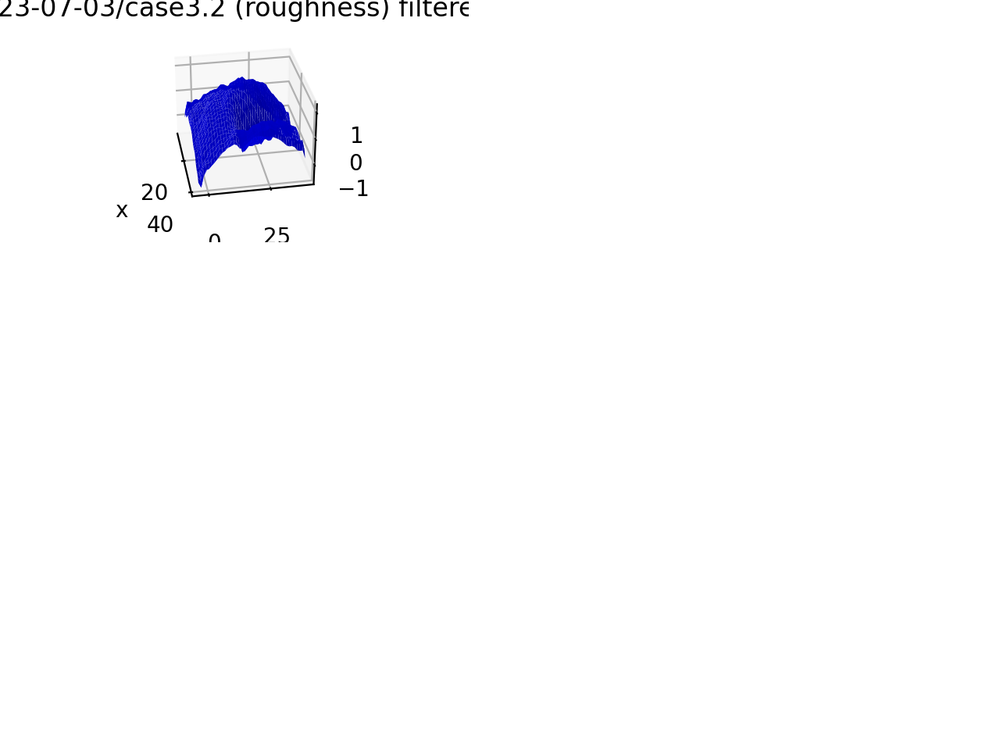

Segments2_compr_flat_filt_5_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5265487805594733
std dev of height =  0.5605199113680966


<IPython.core.display.Javascript object>

Working on segment  6
(44, 27)


<IPython.core.display.Javascript object>

/var/folders/l5/8rwrr2px2fv4cp5w3y1pxfvr0000gn/T/ipykernel_26010/3329496731.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_6_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.41287100252585707
std dev of height =  0.45811606613839995


<IPython.core.display.Javascript object>


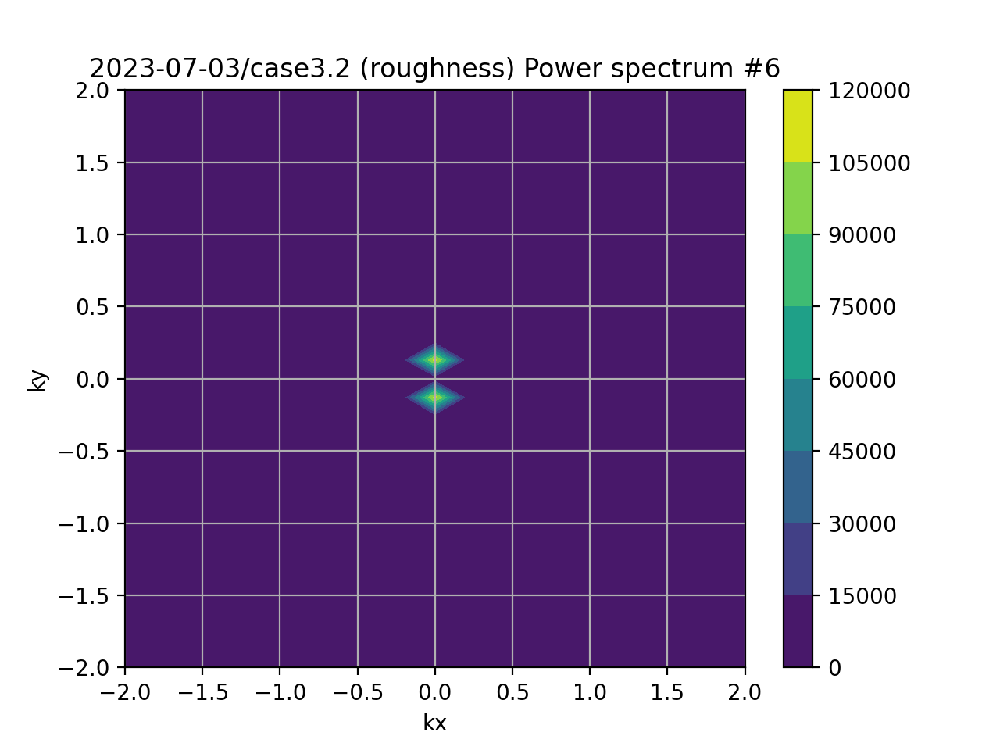

Working on segment  7
(39, 35)


<IPython.core.display.Javascript object>


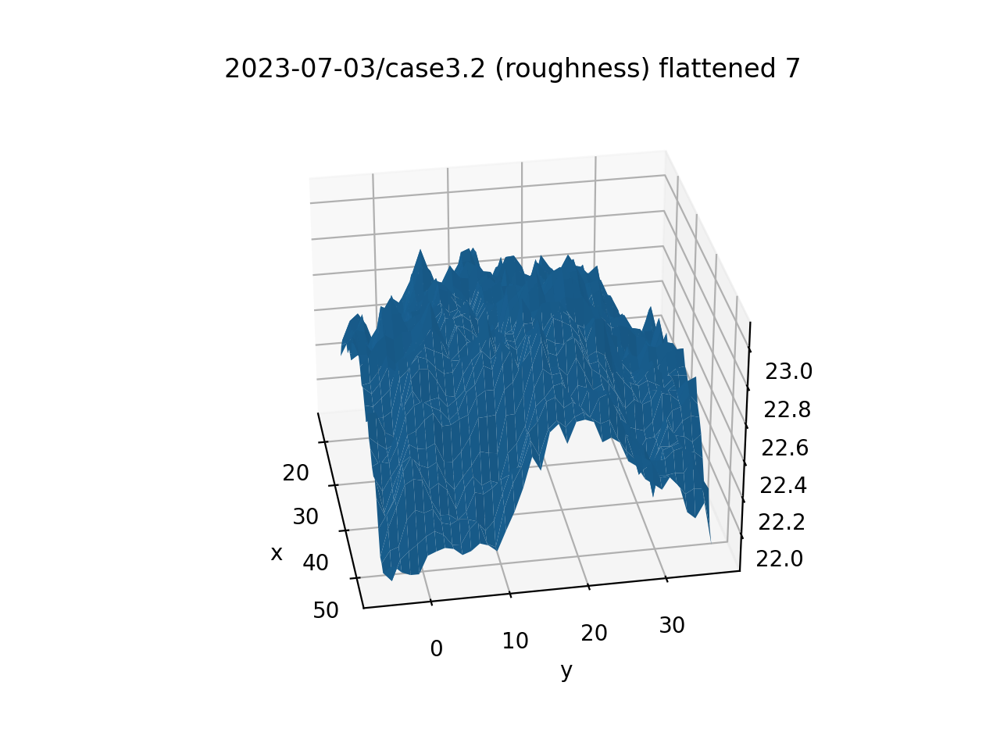

<IPython.core.display.Javascript object>


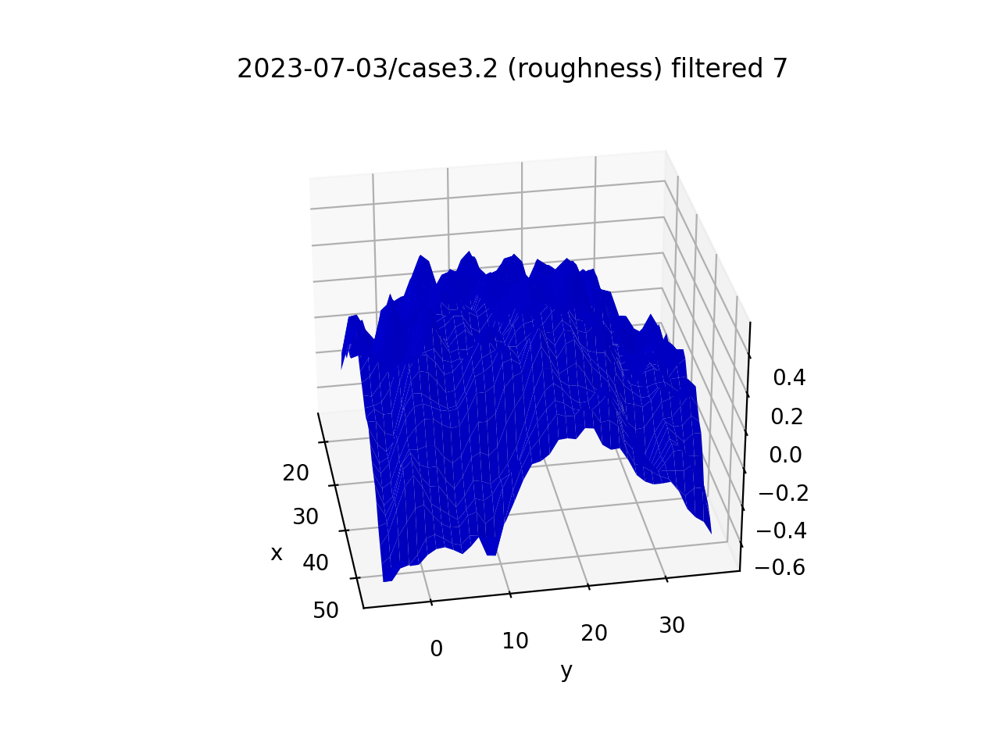

Segments2_compr_flat_filt_7_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.22348143563065323
std dev of height =  0.251497342879719


<IPython.core.display.Javascript object>

Working on segment  8
(37, 38)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


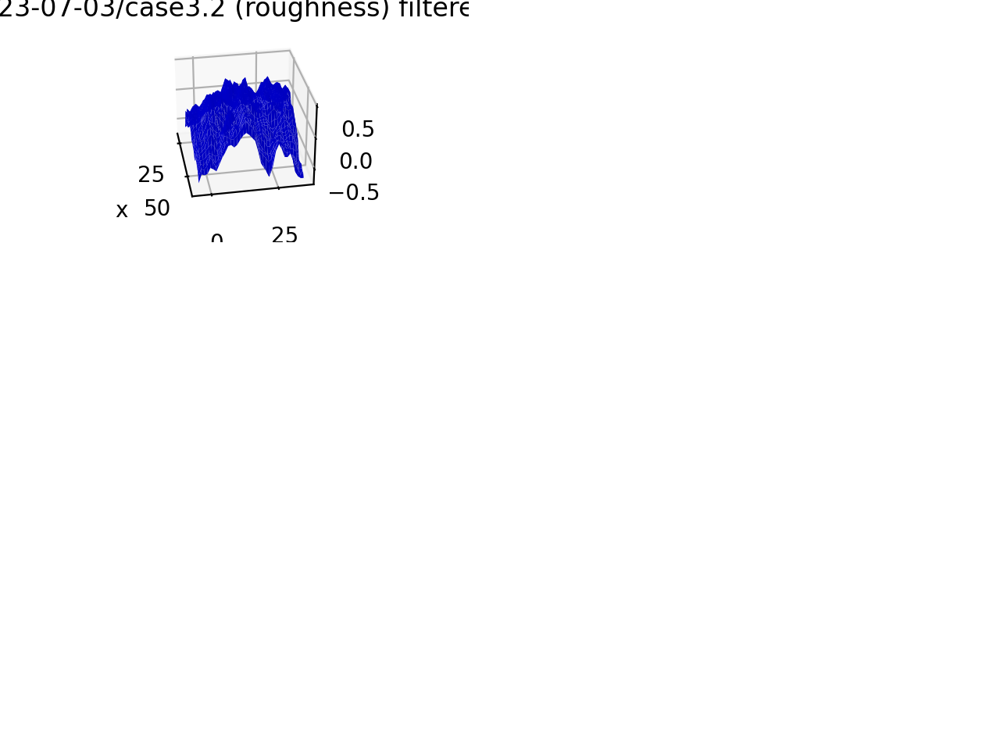

Segments2_compr_flat_filt_8_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.20403107083655833
std dev of height =  0.23961325402770076


<IPython.core.display.Javascript object>


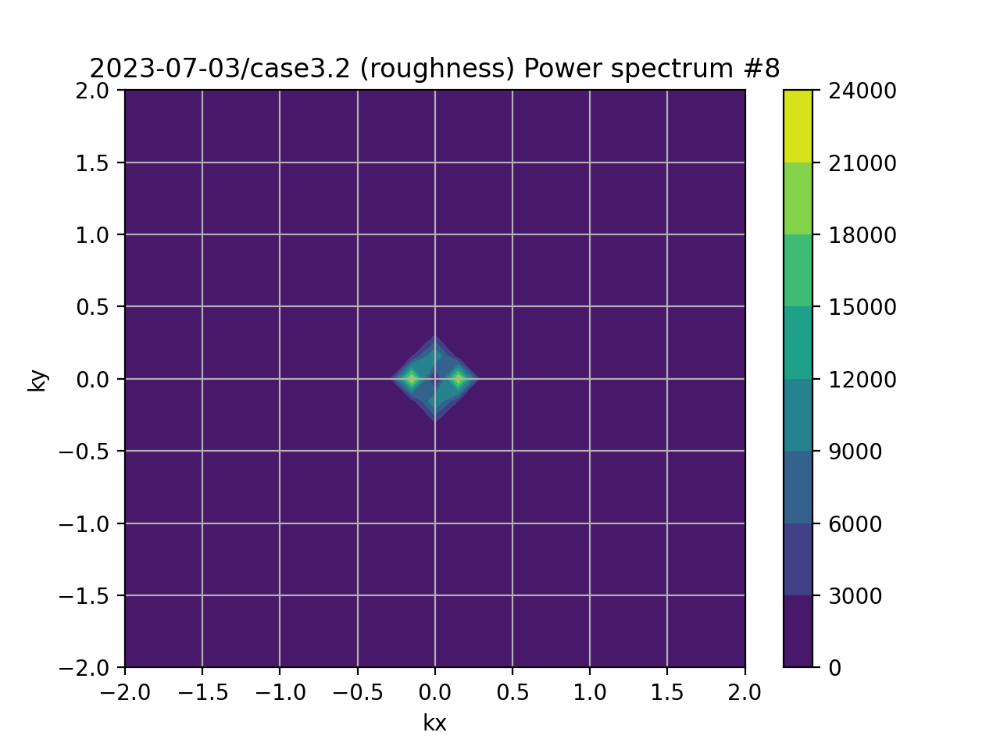

Working on segment  9
(37, 40)


<IPython.core.display.Javascript object>


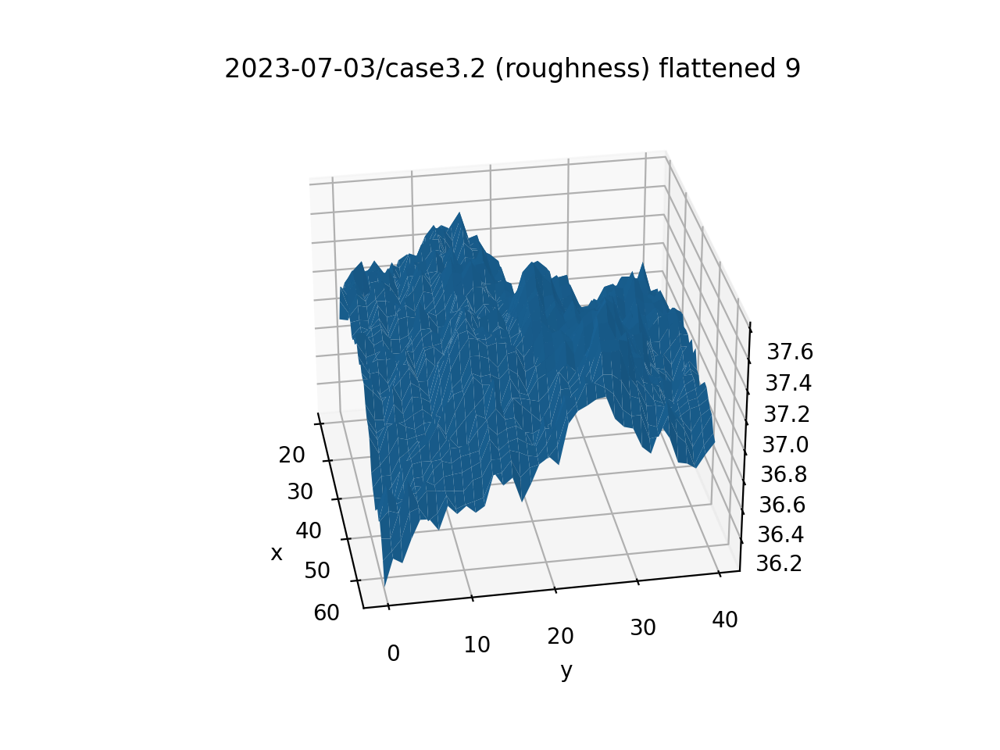

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_9_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.26233317307746346
std dev of height =  0.2820151593481019


<IPython.core.display.Javascript object>

Working on segment  10
(37, 39)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_10_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2820365169400364
std dev of height =  0.30454901680921437


<IPython.core.display.Javascript object>


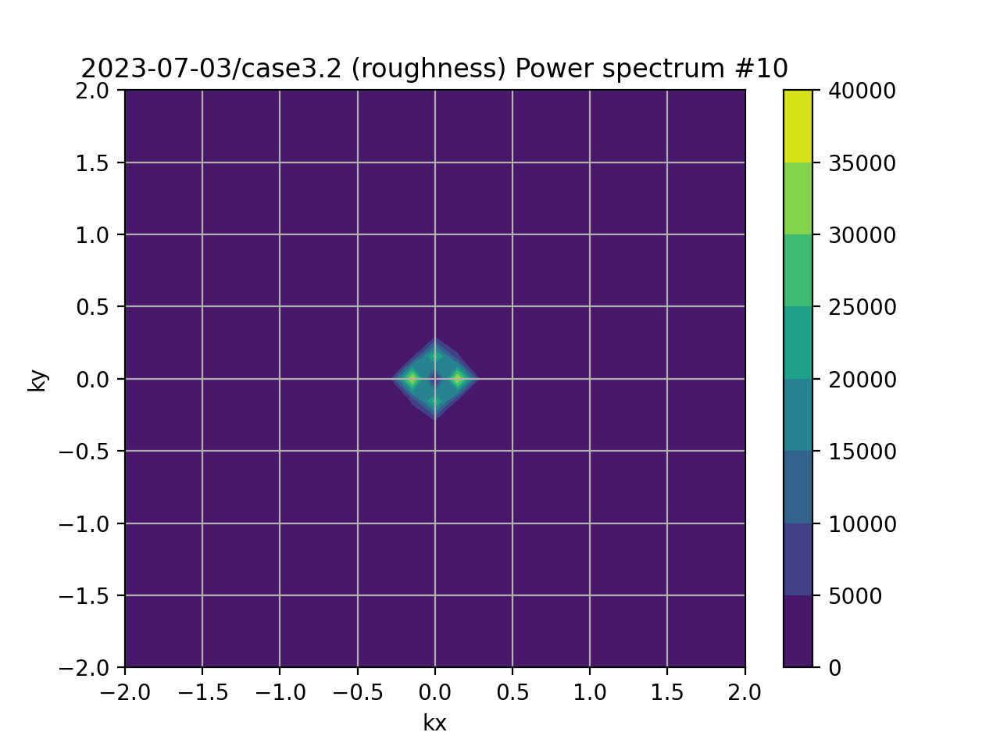

Working on segment  11
(38, 36)


<IPython.core.display.Javascript object>


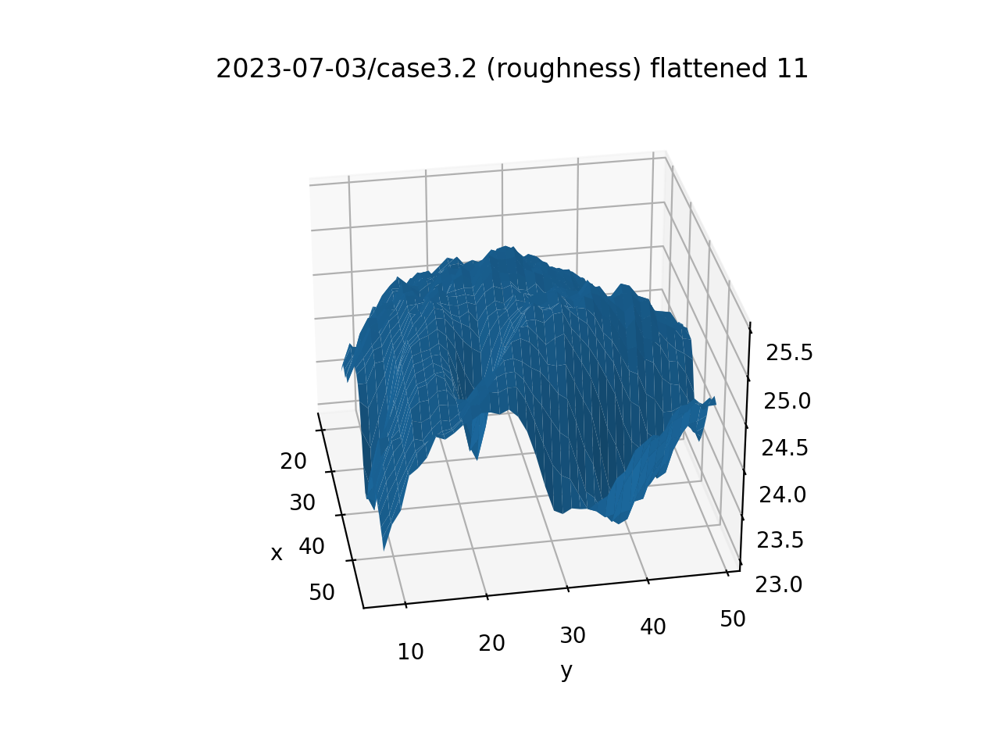

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_11_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.46863145286650637
std dev of height =  0.5071044665642302


<IPython.core.display.Javascript object>

Working on segment  12
(41, 31)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_12_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3049437753338529
std dev of height =  0.33462413561560905


<IPython.core.display.Javascript object>


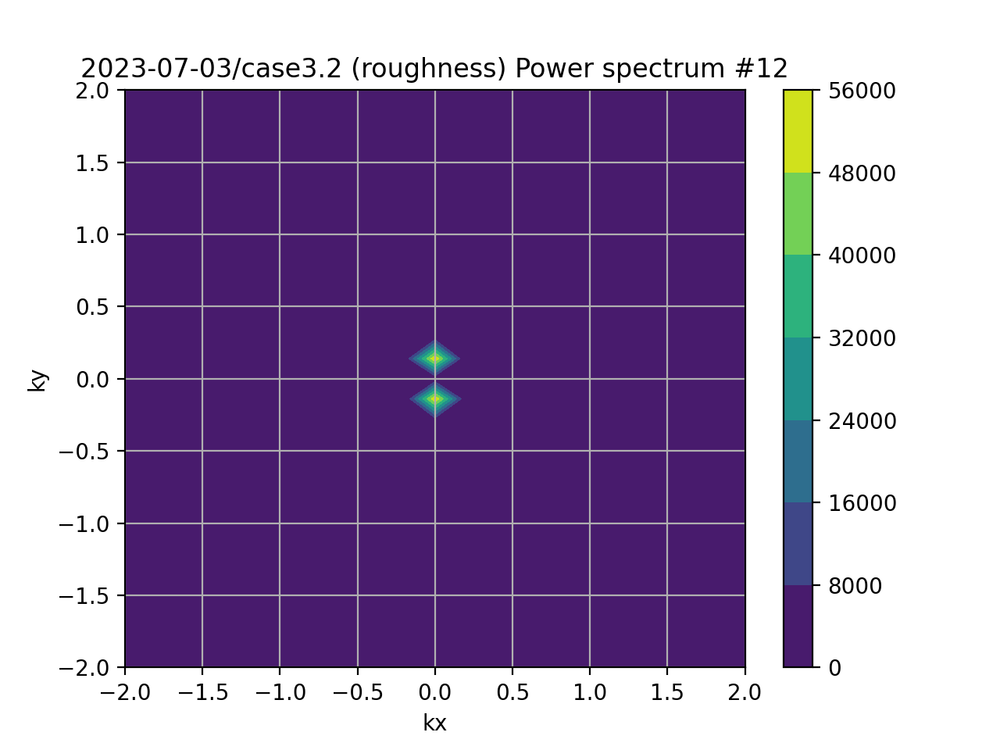

Working on segment  13
(46, 27)


<IPython.core.display.Javascript object>


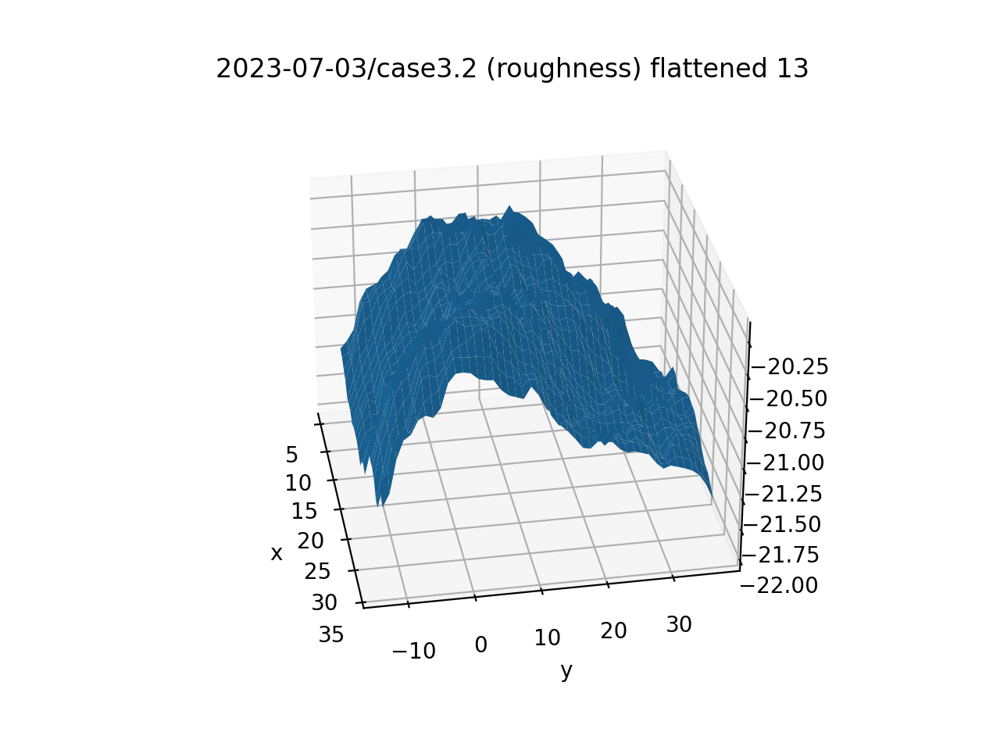

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_13_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3893992004292367
std dev of height =  0.4151249919840606


<IPython.core.display.Javascript object>

Working on segment  14
(39, 34)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_14_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3290848796069326
std dev of height =  0.36880235587668814


<IPython.core.display.Javascript object>

Working on segment  15
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


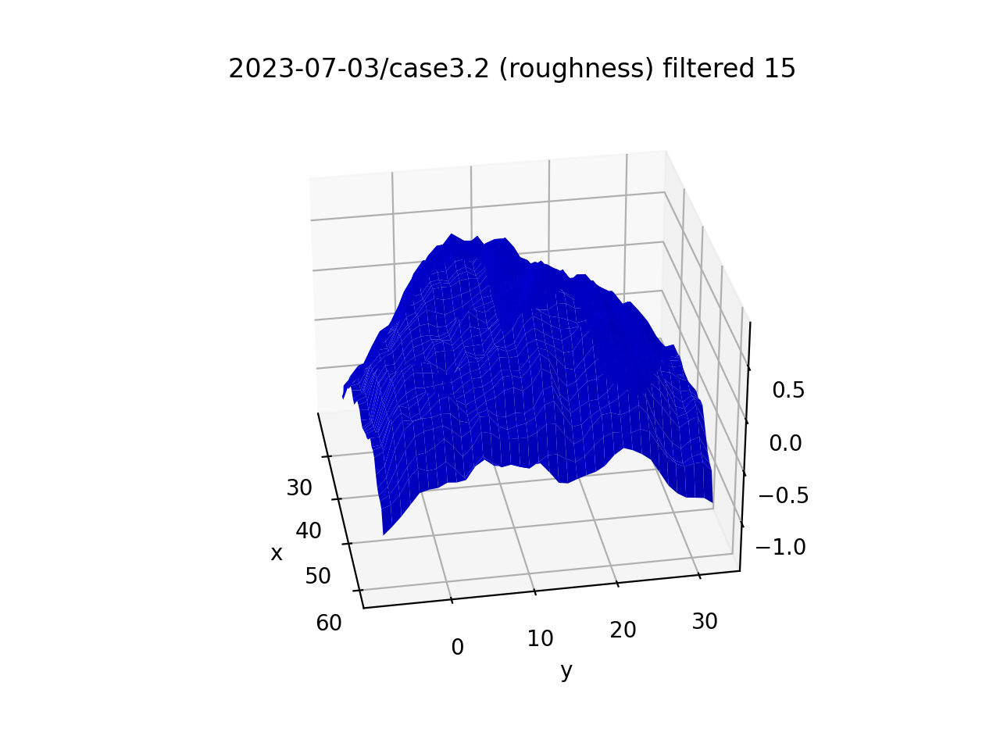

Segments2_compr_flat_filt_15_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3667741829487732
std dev of height =  0.4269776011333994


<IPython.core.display.Javascript object>

Working on segment  16
(37, 38)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


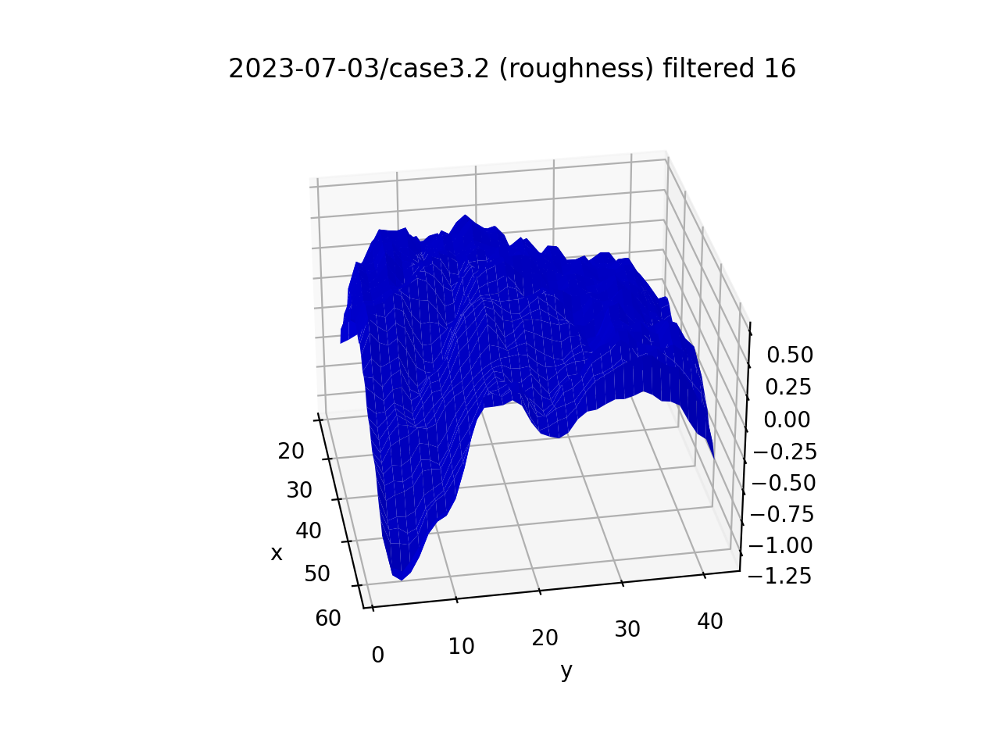

Segments2_compr_flat_filt_16_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3085081778077753
std dev of height =  0.3454601754397469


<IPython.core.display.Javascript object>


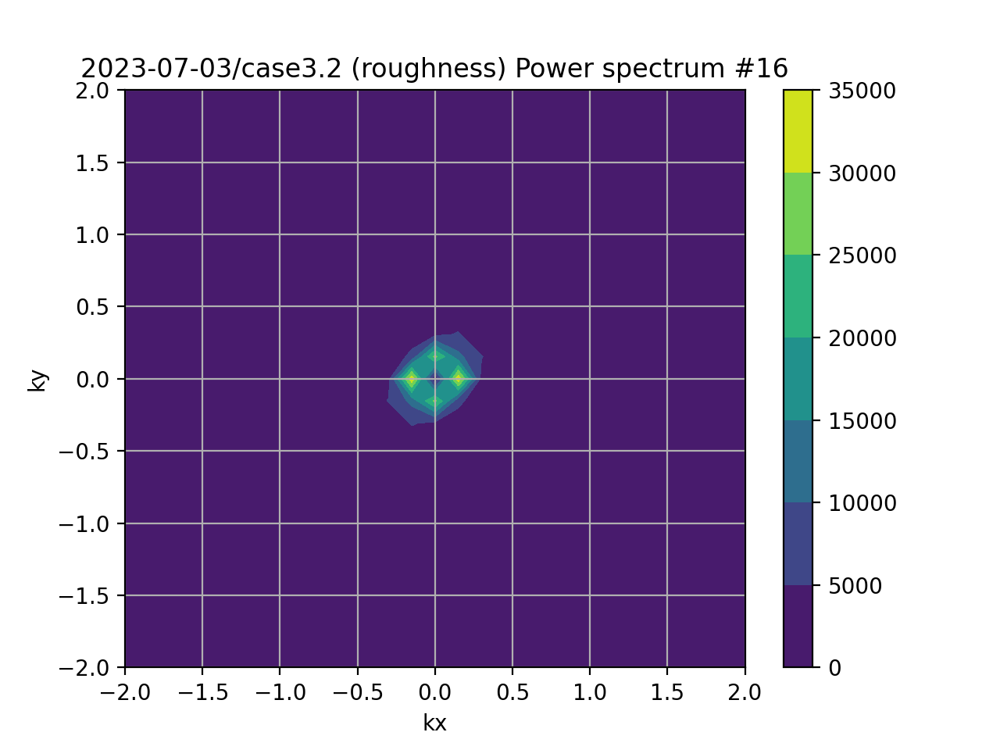

Working on segment  17
(37, 38)


<IPython.core.display.Javascript object>


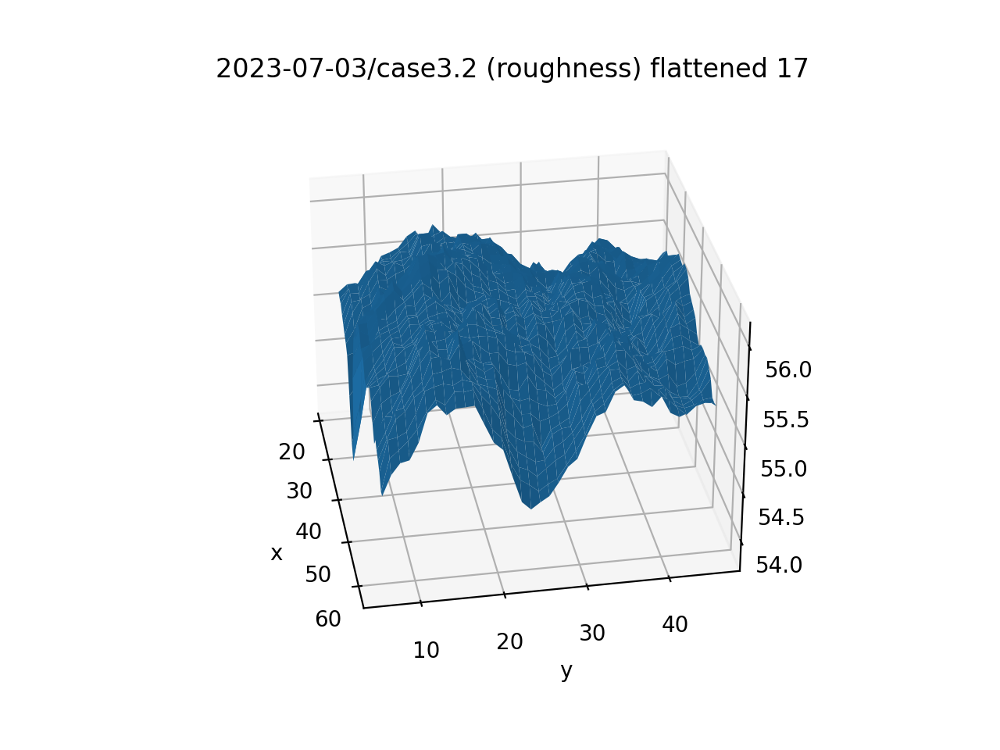

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_17_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.260828719325972
std dev of height =  0.29446581101138636


<IPython.core.display.Javascript object>

Working on segment  18
(38, 35)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


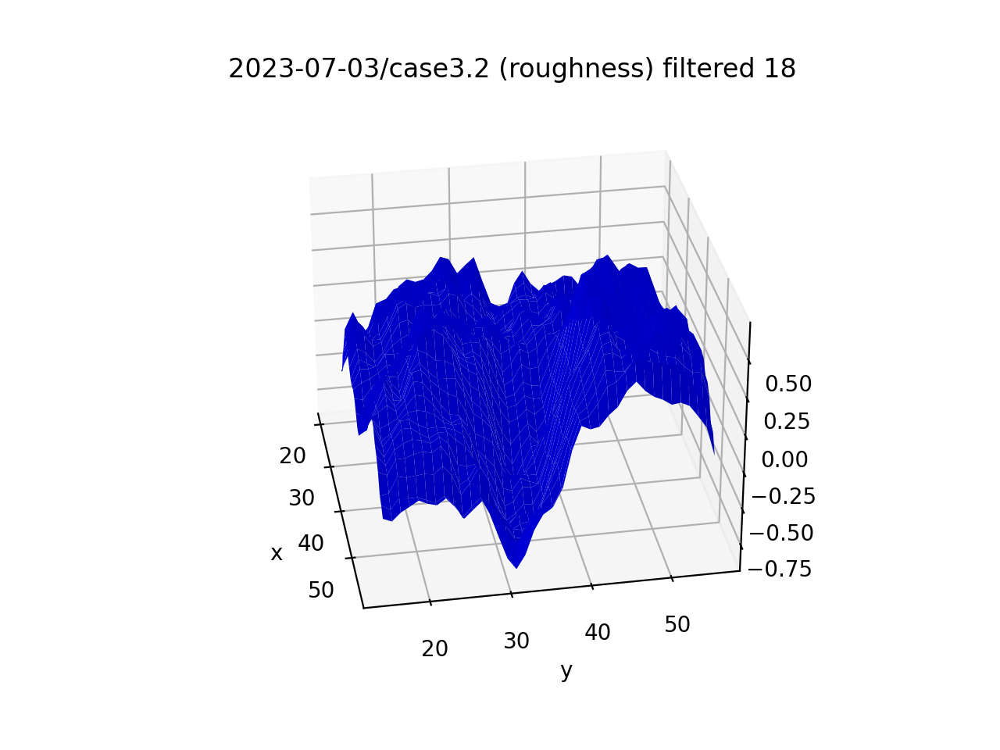

Segments2_compr_flat_filt_18_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.30012334721500533
std dev of height =  0.3073886396749391


<IPython.core.display.Javascript object>


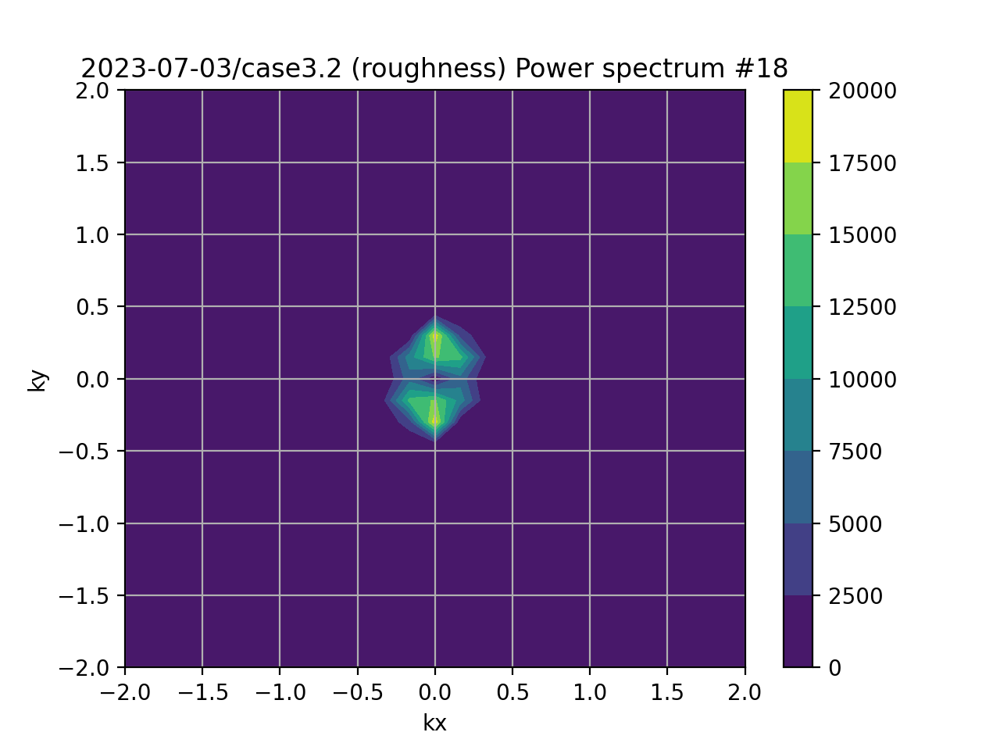

Working on segment  19
(41, 32)


<IPython.core.display.Javascript object>


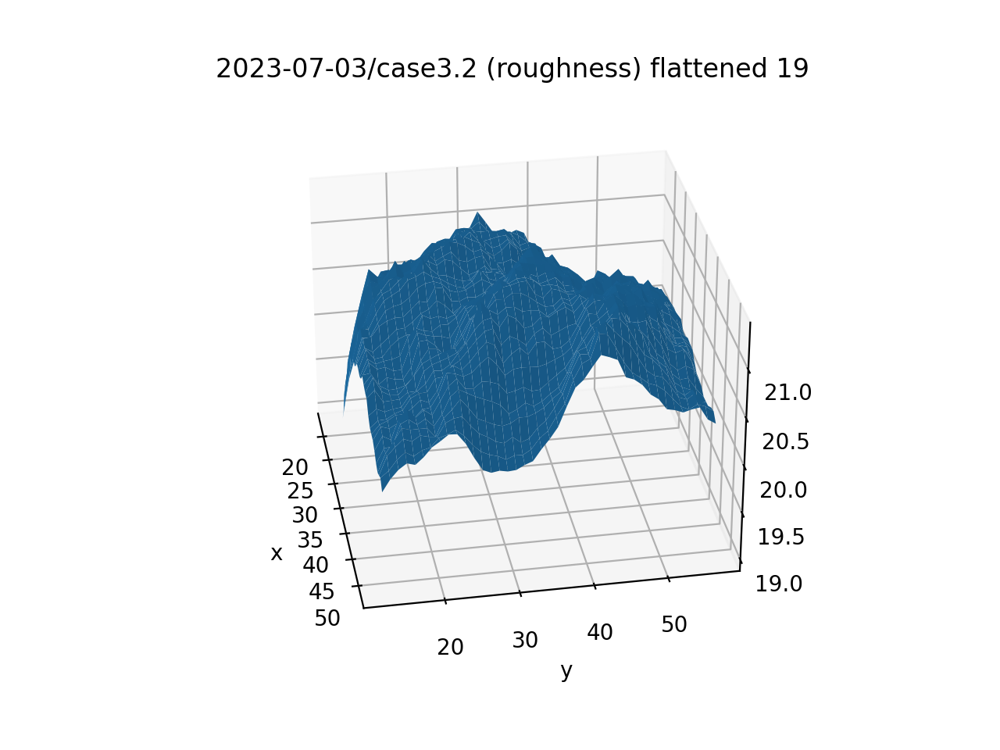

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_19_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.32142566367565784
std dev of height =  0.36155291528026434


<IPython.core.display.Javascript object>

Working on segment  20
(46, 28)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


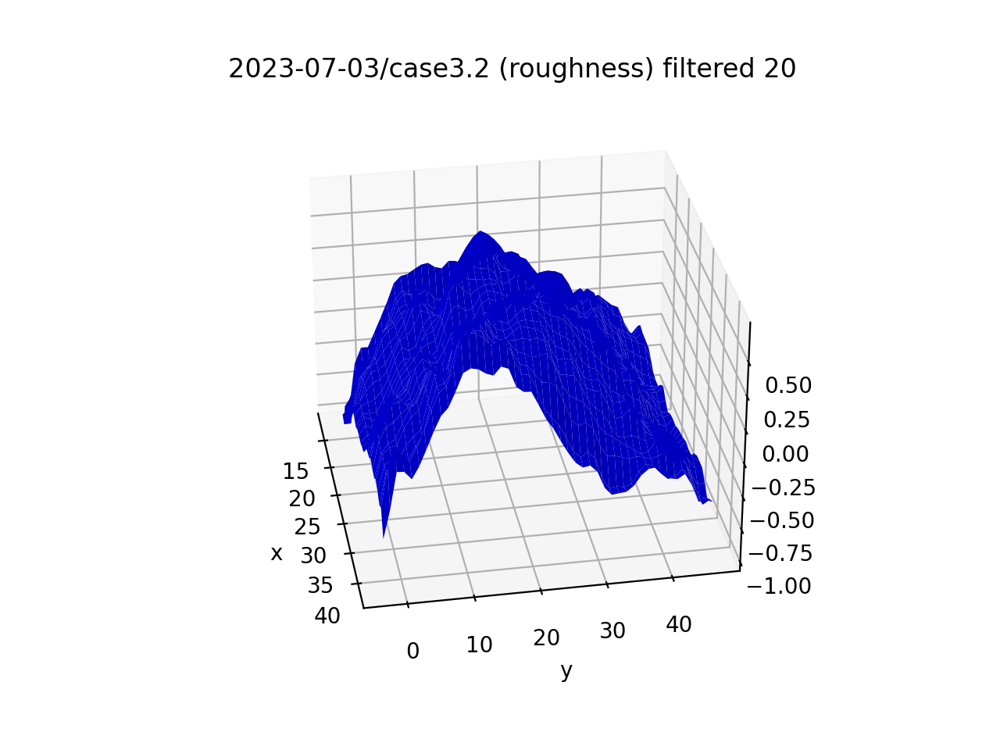

Segments2_compr_flat_filt_20_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3576665275678355
std dev of height =  0.38829584351541047


<IPython.core.display.Javascript object>

Working on segment  21
(38, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


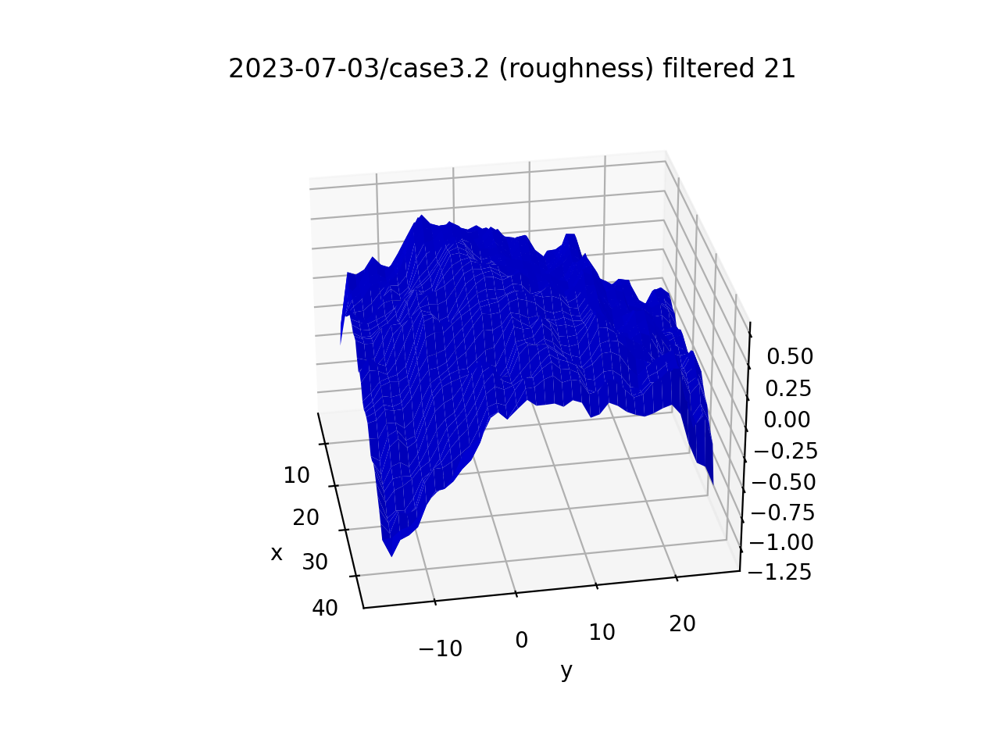

Segments2_compr_flat_filt_21_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2996363361387667
std dev of height =  0.3393915101041917


<IPython.core.display.Javascript object>

Working on segment  22
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_22_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.18877908613181046
std dev of height =  0.2109767056868937


<IPython.core.display.Javascript object>


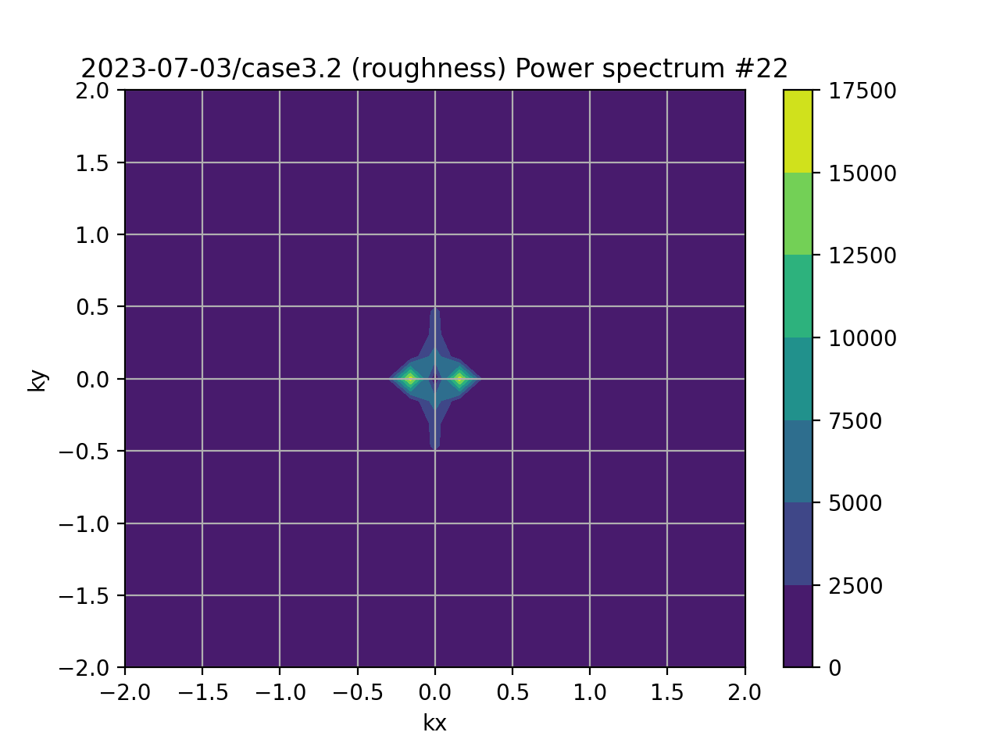

Working on segment  23
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_23_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5146682531057369
std dev of height =  0.5862889911290284


<IPython.core.display.Javascript object>

Working on segment  24
(37, 36)


<IPython.core.display.Javascript object>


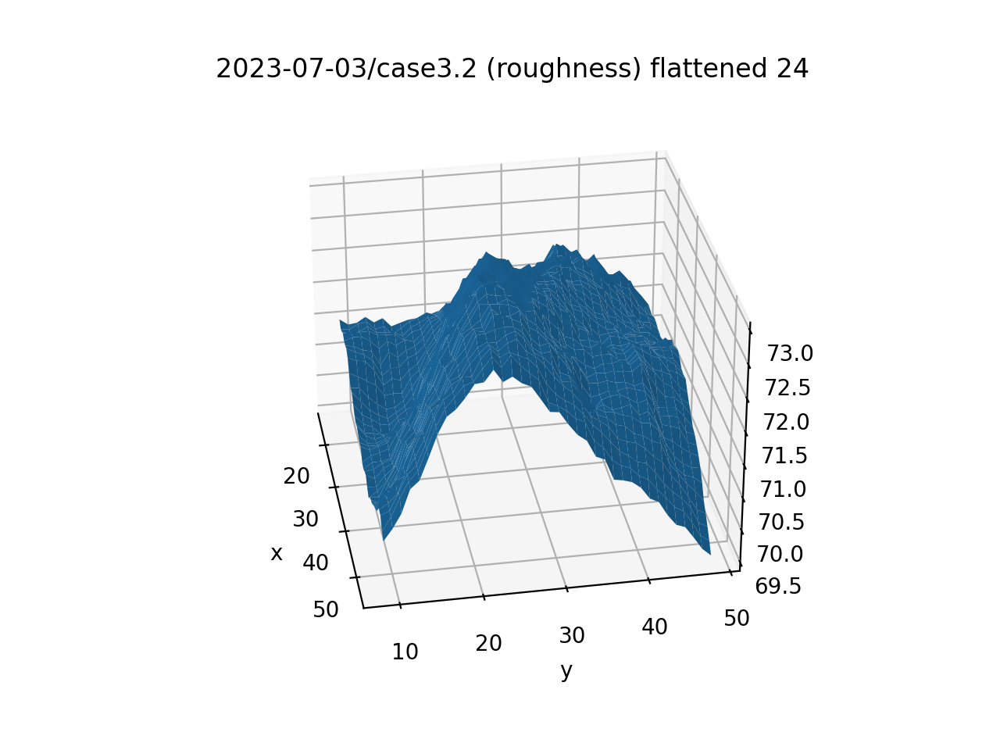

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_24_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.7525530931388338
std dev of height =  0.7806665958764252


<IPython.core.display.Javascript object>

Working on segment  25
(39, 35)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


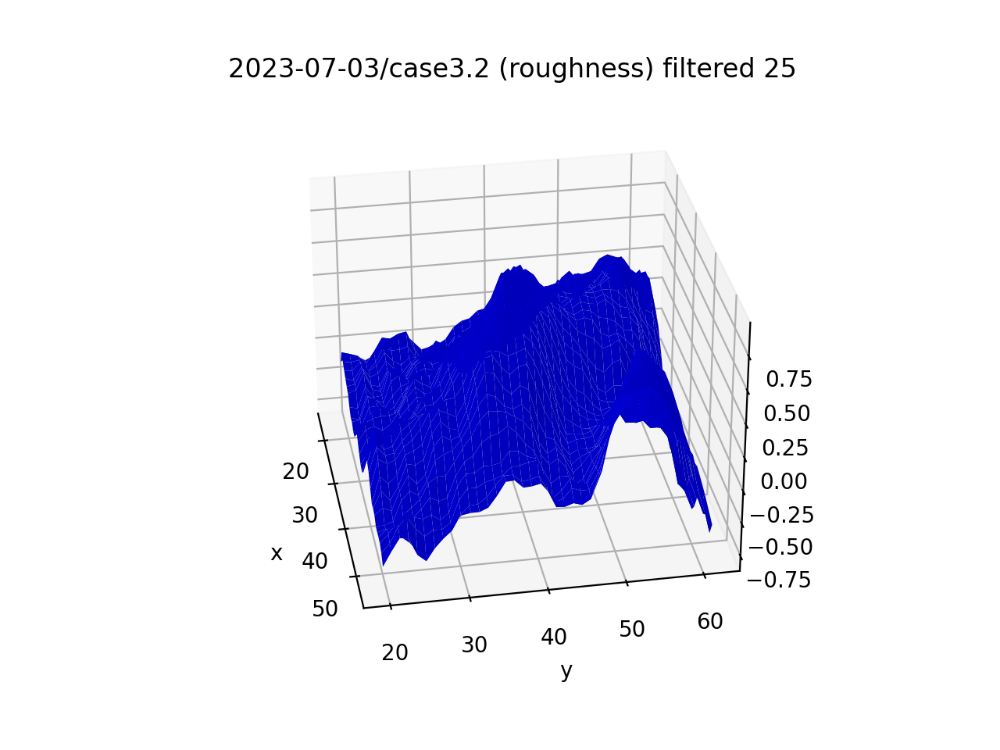

Segments2_compr_flat_filt_25_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3244240606061142
std dev of height =  0.34691829986556544


<IPython.core.display.Javascript object>


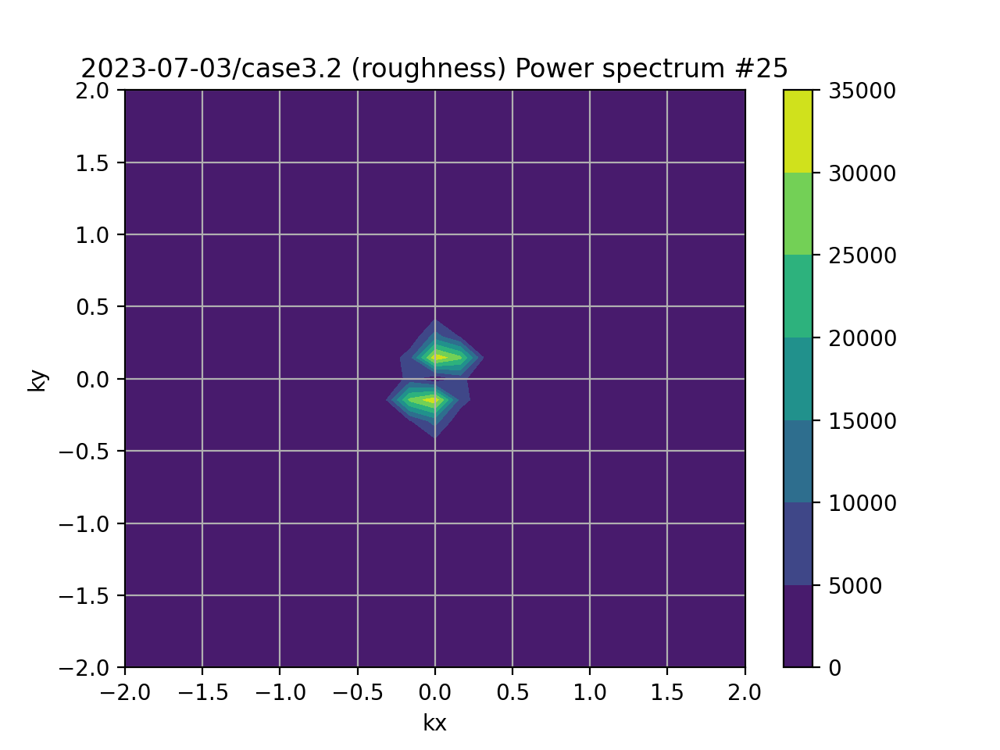

Working on segment  26
(41, 33)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_26_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5100201849248687
std dev of height =  0.5315584277468594


<IPython.core.display.Javascript object>


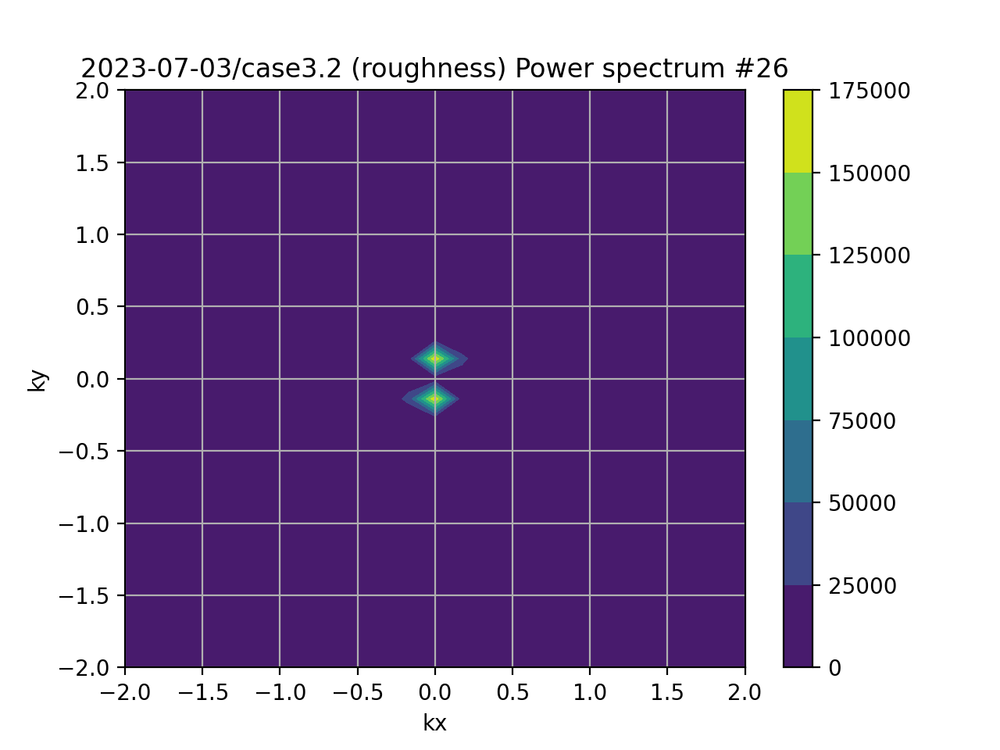

Working on segment  27
(45, 31)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_27_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.4471727643891653
std dev of height =  0.516946995228842


<IPython.core.display.Javascript object>

Working on segment  28
(38, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_28_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.243316032902544
std dev of height =  0.2702419742930695


<IPython.core.display.Javascript object>

Working on segment  29
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_29_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.1461352972444798
std dev of height =  0.15448255618224324


<IPython.core.display.Javascript object>

Working on segment  30
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_30_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.1273056407843016
std dev of height =  0.14328997674437585


<IPython.core.display.Javascript object>

Working on segment  31
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_31_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3292274268393653
std dev of height =  0.38621654189736654


<IPython.core.display.Javascript object>

Working on segment  32
(38, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_32_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.7051548403608182
std dev of height =  0.7878476154496585


<IPython.core.display.Javascript object>

Working on segment  33
(40, 34)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_33_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5218942791166925
std dev of height =  0.5871806992838048


<IPython.core.display.Javascript object>

Working on segment  34
(45, 33)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_34_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.32884415979231596
std dev of height =  0.345528537719567


<IPython.core.display.Javascript object>

Working on segment  35
(38, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_35_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.09845692633077748
std dev of height =  0.1090796232973808


<IPython.core.display.Javascript object>

Working on segment  36
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_36_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.08645997503056178
std dev of height =  0.09314828836533544


<IPython.core.display.Javascript object>

Working on segment  37
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_37_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.12587193243228192
std dev of height =  0.14023120307687956


<IPython.core.display.Javascript object>

Working on segment  38
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_38_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.15531037723606916
std dev of height =  0.18244676295315101


<IPython.core.display.Javascript object>

Working on segment  39
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_39_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5275964295398685
std dev of height =  0.6084931024417739


<IPython.core.display.Javascript object>

Working on segment  40
(40, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_40_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.427253100724841
std dev of height =  0.4752388241135339


<IPython.core.display.Javascript object>

Working on segment  41
(44, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_41_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.4215087911191326
std dev of height =  0.4359888367859889


<IPython.core.display.Javascript object>

Working on segment  42
(38, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_42_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2585411465553027
std dev of height =  0.28317555598789024


<IPython.core.display.Javascript object>

Working on segment  43
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_43_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2551320815179601
std dev of height =  0.30914775104450726


<IPython.core.display.Javascript object>

Working on segment  44
(37, 37)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_44_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.6571554073104804
std dev of height =  0.7547478278581676


<IPython.core.display.Javascript object>

Working on segment  45
(37, 38)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_45_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5494003957831565
std dev of height =  0.6324189164567923


<IPython.core.display.Javascript object>

Working on segment  46
(37, 37)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_46_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.20478124081008411
std dev of height =  0.24297423299003287


<IPython.core.display.Javascript object>

Working on segment  47
(38, 35)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_47_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.4346597134543532
std dev of height =  0.49903935395476634


<IPython.core.display.Javascript object>

Working on segment  48
(41, 34)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_48_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.617038204693943
std dev of height =  0.7275176793335347


<IPython.core.display.Javascript object>

Working on segment  49
(37, 39)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_49_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.6733305511092507
std dev of height =  0.7760683233093711


<IPython.core.display.Javascript object>

Working on segment  50
(37, 41)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_50_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.4486267940767847
std dev of height =  0.4633412540808821


<IPython.core.display.Javascript object>

Working on segment  51
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_51_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.43628191576358294
std dev of height =  0.46044436905312663


<IPython.core.display.Javascript object>

Working on segment  52
(37, 41)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_52_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.4137441382448591
std dev of height =  0.4290605746403552


<IPython.core.display.Javascript object>

Working on segment  53
(37, 40)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_53_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.6065608313738245
std dev of height =  0.6286872328066437


<IPython.core.display.Javascript object>

Working on segment  54
(37, 38)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_54_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.7554568625134014
std dev of height =  0.7587133674516843


<IPython.core.display.Javascript object>

Working on segment  55
(37, 36)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_55_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.6973344623390408
std dev of height =  0.7479454713254727


<IPython.core.display.Javascript object>

Working on segment  56
(37, 40)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_56_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5398345393112584
std dev of height =  0.5821582391921599


<IPython.core.display.Javascript object>

Working on segment  57
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_57_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.8730739437616504
std dev of height =  0.8687019291851173


<IPython.core.display.Javascript object>

Working on segment  58
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_58_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.49878340992015235
std dev of height =  0.528974467113797


<IPython.core.display.Javascript object>

Working on segment  59
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_59_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.5131438145514582
std dev of height =  0.5088400456728434


<IPython.core.display.Javascript object>

Working on segment  60
(37, 41)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_60_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.35163554298976707
std dev of height =  0.364524613147561


<IPython.core.display.Javascript object>

Working on segment  61
(37, 40)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_61_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.7493052250695144
std dev of height =  0.7569038039442315


<IPython.core.display.Javascript object>

Working on segment  62
(37, 40)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_62_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.8572707058918613
std dev of height =  0.849917083664782


<IPython.core.display.Javascript object>

Working on segment  63
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_63_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2710436337066859
std dev of height =  0.2775205676095909


<IPython.core.display.Javascript object>

Working on segment  64
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_64_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.2773644305919724
std dev of height =  0.2771915378604454


<IPython.core.display.Javascript object>

Working on segment  65
(37, 43)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_65_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.35183878841402677
std dev of height =  0.35757177200325907


<IPython.core.display.Javascript object>

Working on segment  66
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_66_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3531861034059474
std dev of height =  0.3473868115589187


<IPython.core.display.Javascript object>

Working on segment  67
(37, 41)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_67_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.6209142767063139
std dev of height =  0.6088893323379027


<IPython.core.display.Javascript object>

Working on segment  68
(37, 41)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_68_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.7104348872995798
std dev of height =  0.6902208453304052


<IPython.core.display.Javascript object>

Working on segment  69
(37, 40)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_69_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.63740330560648
std dev of height =  0.6429629100315027


<IPython.core.display.Javascript object>

Working on segment  70
(37, 45)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_70_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.16625828879927168
std dev of height =  0.18621496040424604


<IPython.core.display.Javascript object>

Working on segment  71
(37, 46)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_71_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.1179192409322683
std dev of height =  0.13551041009417555


<IPython.core.display.Javascript object>

Working on segment  72
(37, 45)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_72_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.14638408806980435
std dev of height =  0.15618672375255085


<IPython.core.display.Javascript object>

Working on segment  73
(37, 44)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_73_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.14260434082078027
std dev of height =  0.15948163397900275


<IPython.core.display.Javascript object>

Working on segment  74
(37, 44)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_74_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.3340622021230271
std dev of height =  0.33611159382240124


<IPython.core.display.Javascript object>

Working on segment  75
(37, 43)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_75_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.25836631626132445
std dev of height =  0.2972827759829936


<IPython.core.display.Javascript object>

Working on segment  76
(37, 42)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Segments2_compr_flat_filt_76_vx5.stl
Creating top mesh...
std dev of height (filtered) =  0.24667965136727665
std dev of height =  0.2539331124596398


<IPython.core.display.Javascript object>

In [12]:
# Fourier transform, filter, and save them
plotthisone = [i for i in range(nsegments)]
vscale = 5
kmax = 2
xseggrid_filtered = []
yseggrid_filtered = []
zseggrid_filtered = []

for i in range(nsegments):
    
    # Reporting
    print('Working on segment ', i)
    
    # Get the next flattened surface
    xgrid = xseggrid[i]
    ygrid = yseggrid[i]
    sollast = zseggrid[i]
    x = xgrid[0,:]; dx = x[1]-x[0]
    y = ygrid[:,0]
    Ny, Nx = np.shape(sollast)

    # Offset to zero
    sollast_offset = np.mean(sollast)
    sollast_atzero = sollast-sollast_offset
    
    # FFT
    solution_filtered = fs.filterseg(kmax,xgrid,ygrid,sollast_atzero)
    sollast_FT_filtered_IFT_real = solution_filtered[0]; print(np.shape(sollast_FT_filtered_IFT_real))
    kxshiftgrid = solution_filtered[1]
    kyshiftgrid = solution_filtered[2]
    sollast_FTshift_square = solution_filtered[3]
    
    # Plot one of them
    if i in plotthisone:
        
        # Graphing the flattened surface as a mesh
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.plot_surface(xseggrid[i], yseggrid[i], zseggrid[i])
        ax.set_xlabel('x')
        ax.set_ylabel('y')
        ax.set_title(case_and_folder + ' flattened '+str(i))
        ax.view_init(30, -10)
                
        # Save an stl file
        #stlfilename = Segmentroot+'_compr_flat'+'_'+str(i)+'_vx'+str(vscale)+'.stl'; print(stlfilename)
        #sls.numpy2stl(np.fliplr(zseggrid[i]), stlfilename, scale=vscale/dx, solid=False)

        # Graphing the filtered flattened surface as a mesh
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.plot_surface(xseggrid[i], yseggrid[i], sollast_FT_filtered_IFT_real,color='blue')
        ax.set_xlabel('x')
        ax.set_ylabel('y')
        ax.set_title(case_and_folder + ' filtered '+str(i))
        ax.view_init(30, -10)
        
        # Save an stl file
        stlfilename = Segmentroot+'_compr_flat_filt'+'_'+str(i)+'_vx'+str(vscale)+'.stl'; print(stlfilename)
        sls.numpy2stl(np.fliplr(sollast_FT_filtered_IFT_real[1:-2,1:-2]), stlfilename, scale=vscale/dx, solid=False)
        
        # Report something about the heights
        print ('std dev of height (filtered) = ', np.std(sollast_FT_filtered_IFT_real[1:-2,1:-2]))
        print ('std dev of height = ', np.std(sollast))
        
        # FT plotting
        plt.figure()
        plt.contourf(kxshiftgrid, kyshiftgrid, sollast_FTshift_square)
        plt.colorbar()
        plt.xlim([-kmax,kmax])
        plt.ylim([-kmax,kmax])
        plt.xlabel('kx')
        plt.ylabel('ky')
        plt.title(case_and_folder + ' Power spectrum #'+str(i))
        plt.grid(True)
        
    # Pack the filtered segment into the big array (but getting rid of the edges)
    xseggrid_filtered.append(xgrid[1:-2,1:-2])
    yseggrid_filtered.append(ygrid[1:-2,1:-2])
    zseggrid_filtered.append(sollast_FT_filtered_IFT_real[1:-2,1:-2])

In [13]:
# Graphing the filtered flattened surface with plotly
print('plotting the last one')
fig = go.Figure(data=go.Surface(x=xseggrid[i],y=yseggrid[i],z=sollast_FT_filtered_IFT_real, colorscale="greys"))
fig.update_layout(scene = dict(
            xaxis_title='x',
            yaxis_title='y',
            zaxis_title='z'),
            title='test')

plotting the last one


In [14]:
# Do some uniforimization on the unfiltered array
nxmin,nymin = np.shape(xseggrid_filtered[0])
for i in range(len(xseggrid_filtered)):
    nx, ny = np.shape(xseggrid_filtered[i])
    if (nx<nxmin):
        nxmin = nx
    if (ny<nymin):
        nymin = ny
print('minima:', nxmin,nymin)
xseggrid_filtered_uni = []
yseggrid_filtered_uni = []
zseggrid_filtered_uni = []
for i in range(len(xseggrid_filtered)):
    xseggrid_filtered_uni.append(xseggrid_filtered[i][0:nxmin,0:nymin])
    yseggrid_filtered_uni.append(yseggrid_filtered[i][0:nxmin,0:nymin])
    zseggrid_filtered_uni.append(zseggrid_filtered[i][0:nxmin,0:nymin])

# Do some uniformization on the unfiltered array
nxmin,nymin = np.shape(xseggrid[0])
for i in range(len(xseggrid)):
    nx, ny = np.shape(xseggrid[i])
    if (nx<nxmin):
        nxmin = nx
    if (ny<nymin):
        nymin = ny
print('minima:', nxmin,nymin)
xseggrid_uni = []
yseggrid_uni = []
zseggrid_uni = []
for i in range(len(xseggrid_filtered)):
    xseggrid_uni.append(xseggrid[i][0:nxmin,0:nymin])
    yseggrid_uni.append(yseggrid[i][0:nxmin,0:nymin])
    zseggrid_uni.append(zseggrid[i][0:nxmin,0:nymin])

minima: 34 24
minima: 37 27


In [15]:
# Save the flattened segments
np.savez_compressed(Originalfilename, \
                    xgridtot=surf_xseggrid, \
                    ygridtot=surf_yseggrid, \
                    zgridtot=surf_zseggrid)

np.savez_compressed(Flattenedfilename, \
                    xgridtot=xseggrid_uni, \
                    ygridtot=yseggrid_uni, \
                    zgridtot=zseggrid_uni)

np.savez_compressed(Filteredfilename, \
                    xgridtot=xseggrid_filtered_uni, \
                    ygridtot=yseggrid_filtered_uni, \
                    zgridtot=zseggrid_filtered_uni)

In [16]:
# See if we can get some angles
ims.extractdots(npzfile,dx,dy)

0 1 0.994019175268502 6.269528183626602
0 2 0.971166806522124 13.79218493187646
0 3 0.9227973954639265 22.66146965518489
0 4 0.8659733646906709 30.005962703499925
0 5 0.7576992018467446 40.73821769888366
0 6 0.6163721631935994 51.94830809509276
0 7 0.9852842091259401 9.841548995020501
0 8 0.972066667701928 13.574228717700848
0 9 0.9377820390544817 20.31764625729315
0 10 0.8930911581249131 26.735711969107133
0 11 0.8231476037360853 34.598866345057985
0 12 0.6832115893658515 46.90487940414566
0 13 0.5694775694704869 55.28619688487848
0 14 0.9540768871601809 17.4312878668843
0 15 0.9248881837865272 22.348499899936527
0 16 0.8802343981222306 28.32934833757863
0 17 0.8535431488528186 31.400841092051838
0 18 0.7470682639122341 41.66294394779556
0 19 0.6522361019348957 49.28959269318693
0 20 0.5471650534971004 56.82725965961033
0 21 0.8061892827625604 36.274732456694224
0 22 0.7875088307790729 38.04668649146849
0 23 0.7881504675740374 37.98699580212946
0 24 0.7855026667388666 38.2328072836519

23 28 0.9841256804905854 10.222600268173077
23 29 0.9916995507766707 7.3873604553538845
23 30 0.994257095118245 6.143438339382635
23 31 0.9968191205790884 4.571159976323824
23 32 0.9422750886565942 19.562793442193517
23 33 0.873081823062603 29.181233449957553
23 34 0.775570866493811 39.143181999196635
23 35 0.9787233159129506 11.840298550652522
23 36 0.9870966030397552 9.214202605848843
23 37 0.9889251422043905 8.535094584190487
23 38 0.9895433777321454 8.293016043978636
23 39 0.9601420933230345 16.23110312599963
23 40 0.8799552681904359 28.36303207597625
23 41 0.7853269784498333 38.249070110070186
23 42 0.973826757635251 13.137665897862227
23 43 0.9739492889549453 13.106742378899574
23 44 0.9602538215875029 16.20818478670267
23 45 0.929200786104418 21.689427051562017
23 46 0.9104532000001944 24.431944277588897
23 47 0.8872355941342316 27.47209762904256
23 48 0.8394887534851864 32.91382743411813
23 49 0.8798014669139402 28.381576233416542
23 50 0.853730593966626 31.38022204423638
23 51

In [17]:
# # This is just trying to understand how the FT works
# i = 0
# x = xseggrid[i][0,:]
# y = yseggrid[i][:,0]
# xgrid,ygrid = np.meshgrid(x,y)
# test = xseggrid[0]
# Ny, Nx = np.shape(test)

# # FT
# test_FTshift,kxshift,kyshift = fs.FT(test,x,y)
# kxshiftgrid,kyshiftgrid = np.meshgrid(kxshift,kyshift);
# test_FTshift_square = np.real(test_FTshift)**2 +  np.imag(test_FTshift)**2 
# plt.figure()
# plt.contour(kxshiftgrid, kyshiftgrid, test_FTshift_square)
# plt.xlabel('kx')
# plt.ylabel('ky')
# plt.title('Power spectrum')
# plt.grid(True)

# # Filter
# kmax = 2.6
# test_FTshift_filtered = test_FTshift*1
# for ix in range(Nx):
#     for iy in range(Ny):
#         ktest = np.sqrt(kxshiftgrid[iy,ix]**2+kyshiftgrid[iy,ix]**2)
#         if(ktest>kmax):
#             test_FTshift_filtered[iy,ix]=0

# # Inverse FT
# test_FT_filtered_IFT = fs.IFT(test_FTshift_filtered)
# print(np.shape(test_FT_filtered_IFT))
# print(np.shape(xgrid))

# # Plotting
# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')
# ax.plot_surface(xseggrid[i], yseggrid[i], test)
# ax.set_xlabel('x')
# ax.set_ylabel('y')
# ax.set_title('original')
# ax.view_init(30, -10)

# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')
# ax.plot_surface(xgrid, ygrid, np.real(test_FT_filtered_IFT),color='blue')
# ax.set_xlabel('x')
# ax.set_ylabel('y')
# ax.set_title('smoothed')
# ax.view_init(30, -10)

# # fig = plt.figure()
# # ax = fig.add_subplot(111, projection='3d')
# # ax.plot_surface(xgrid, ygrid, np.real(test_FT_filtered_IFT-test),color='red')
# # ax.set_xlabel('x')
# # ax.set_ylabel('y')
# # ax.set_title('real difference')
# # ax.view_init(30, -10)

In [18]:
# # More attempts to understand how the FT works
# x = np.linspace(0,20,50)
# y = np.linspace(0,20,51)
# xgrid,ygrid = np.meshgrid(x,y)
# lambdax = 5; kx = np.pi*2/lambdax; print(kx)
# lambday = 2; ky = np.pi*2/lambday; print(ky)
# sollast = np.sin(kx*xgrid) + np.sin(ky*ygrid)
# Ny, Nx = np.shape(sollast)

# # FT
# sollast_FTshift,kxshift,kyshift = fs.FT(sollast,x,y)
# kxshiftgrid,kyshiftgrid = np.meshgrid(kxshift,kyshift);
# sollast_FTshift_square = np.real(sollast_FTshift)**2 +  np.imag(sollast_FTshift)**2 


# # Plotting
# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')
# ax.plot_surface(xgrid, ygrid, sollast)
# ax.set_xlabel('x')
# ax.set_ylabel('y')
# ax.set_title('original')

# plt.figure()
# plt.contour(kxshiftgrid, kyshiftgrid, sollast_FTshift_square)
# plt.xlabel('kx')
# plt.ylabel('ky')
# plt.title('Power spectrum')
# plt.grid(True)
